In [1]:
# centroids generated from this step do not go through the pixel filter!
# but centroids from first half were generated via this step soooooooooooooooooo
# I could generate some centroids from the first half and compare to current values
# looks like I already generated those values
#so why is second half getting flagged? differently
#doesnt explain why there are half differences but does explain the fact the flower is getting picked up p frequ. 
#one filter only saves centroid values for objects with a contour larger than x
#the other filter saves in and out values for 

In [3]:
import time
import numpy as np
import cv2
import pandas as pd
import matplotlib.pyplot as plt
from scipy import signal
import os, errno
import glob

In [4]:
def erodeimg(image):
    kernel = np.ones((4,4), np.uint8)
    erode = cv2.erode(image, kernel, iterations = 1)
    return erode

In [5]:
def dilateimg(image):
    kernel = np.ones((3,3), np.uint8)
    dilate = cv2.dilate(image, kernel, iterations = 1)
    return dilate

In [5]:
def MotionParameters(image):
    eroded = erodeimg(image)
    dilated = dilateimg(eroded)


    mask = cv2.inRange(dilated, 5, 200)
    kernel = np.ones((10,10), np.uint8)
    close = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    _, contours, hierarchy = cv2.findContours(close, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    area = [cv2.contourArea(c) for c in contours]
    areas = np.asarray(area)
#     areas[areas < 500] = 0
    
    if (len(contours) >= 1) & np.any(areas):
        max_i = np.argmax(areas)
        contour_ = contours[max_i]
        contour_h = cv2.convexHull(contour_)
        
        M = cv2.moments(contour_)
        hM = cv2.moments(contour_h)
        centroid_ = (int(M["m10"]/M["m00"])), (int(M["m01"]/M["m00"]))
        centroid_h = (int(hM["m10"]/hM["m00"])), (int(hM["m01"]/hM["m00"]))
    else:
        contour_ = ()
        contour_h = ()
        centroid_ = (np.nan, np.nan)
        centroid_h = (np.nan, np.nan)
    return contour_, contour_h, centroid_, centroid_h

In [6]:
def VideoPull(back_frame, current_frame, file_name, path):
    video = [(os.path.join(root, file), file[0:-4]) 
        for root, dirs, files in os.walk(path) 
        for file in files 
        if file.endswith(file_name + '.mp4')]
    cam = cv2.VideoCapture(video[0][0])
    cam.set(1,back_frame)
    ret, f = cam.read(1)
    background = cv2.cvtColor(f, cv2.COLOR_BGR2GRAY)
    cam.set(1,current_frame)
    ret, c = cam.read(1)
    current = cv2.cvtColor(c, cv2.COLOR_BGR2GRAY)
    difference = cv2.subtract(current,background)

    return background, current, difference

In [7]:
def FrameSequence(file_name, path):
    video = [(os.path.join(root, file), file[0:-4]) 
        for root, dirs, files in os.walk(path) 
        for file in files 
        if file.endswith(file_name + '.mp4')]
    cam = cv2.VideoCapture(video[0][0])
    cam.set(1,0)
    frame_sequence = list(range(0,int(cam.get(cv2.CAP_PROP_FRAME_COUNT))))

    return frame_sequence

In [18]:
file_truet = r"C:\Users\Daniellab\Desktop\Light_level_videos_second_batch\Data\Step6\AllLight_EveryMoth.csv"
location = r'C:\Users\Daniellab\Desktop\Light_level_videos_second_batch\Data\Motion_Analysis\Centroids'
outpath = r'C:\Users\Daniellab\Desktop\Light_level_videos_second_batch\Data\Motion_Analysis\Centroids\Figure'
video = r"C:\Users\Daniellab\Desktop\Light_level_videos_second_batch\Videos\All_videos_used_for_analysis"
contour_vid = r"C:\Users\Daniellab\Desktop\Light_level_videos_second_batch\Data\Motion_Analysis\Centroids\Figure"

In [9]:
dFrame = pd.read_csv(file_truet)
list_videos = dFrame.name.unique()

for name in list_videos:
    i = 0
    In_frame = list(dFrame[(dFrame.name == name) & (dFrame.In_Frame.notnull())].In_Frame)
    
    Out_frame = list(dFrame[(dFrame.name == name) & (dFrame.Out_Frame.notnull())].Out_Frame)
    print(len(In_frame), name)

4 L0.1_c-3_m10
3 L0.1_c-3_m12
63 L0.1_c-3_m20
63 L0.1_c-3_m21
20 L0.1_c-3_m22
7 L0.1_c-3_m23
1 L0.1_c-3_m24
2 L0.1_c-3_m25
9 L0.1_c-3_m27
10 L0.1_c-3_m2
20 L0.1_c-3_m32
26 L0.1_c-3_m34
7 L0.1_c-3_m37
13 L0.1_c-3_m38
14 L0.1_c-3_m39
25 L0.1_c-3_m40
15 L0.1_c-3_m41
12 L0.1_c-3_m43
34 L0.1_c-3_m44
47 L0.1_c-3_m45
14 L0.1_c-3_m46
45 L0.1_c-3_m47
6 L0.1_c-3_m48
35 L0.1_c-3_m49
11 L0.1_c-3_m50
53 L0.1_c-3_m54
46 L0.1_c-3_m57
38 L0.1_c-3_m5
22 L0.1_c-3_m8
8 L50_c-3_m10
25 L50_c-3_m12
22 L50_c-3_m13
14 L50_c-3_m14
24 L50_c-3_m15
25 L50_c-3_m21
49 L50_c-3_m22
1 L50_c-3_m24
1 L50_c-3_m25
11 L50_c-3_m26
2 L50_c-3_m2
3 L50_c-3_m30
33 L50_c-3_m32
3 L50_c-3_m33
4 L50_c-3_m34
9 L50_c-3_m35
11 L50_c-3_m37
8 L50_c-3_m38
32 L50_c-3_m39
14 L50_c-3_m45
17 L50_c-3_m49
6 L50_c-3_m50
10 L50_c-3_m51
5 L50_c-3_m58
8 L50_c-3_m6
8 L50_c-3_m9


L0.1_c-3_m40


C:\Users\Daniellab\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


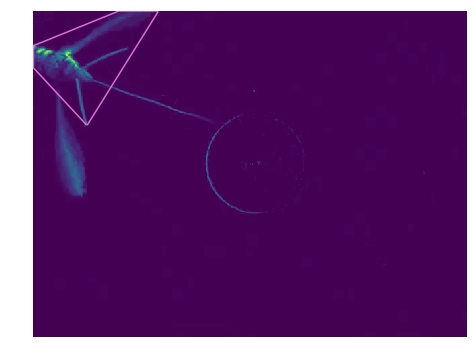

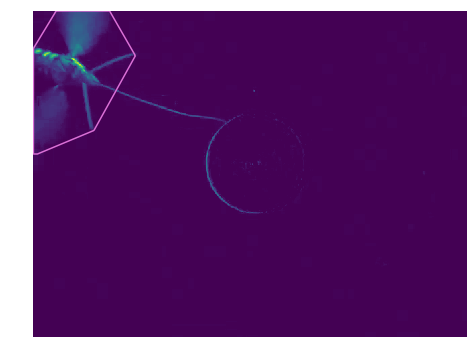

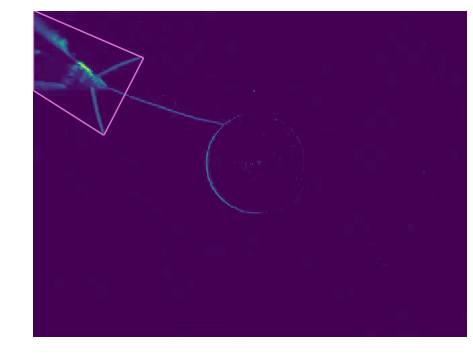

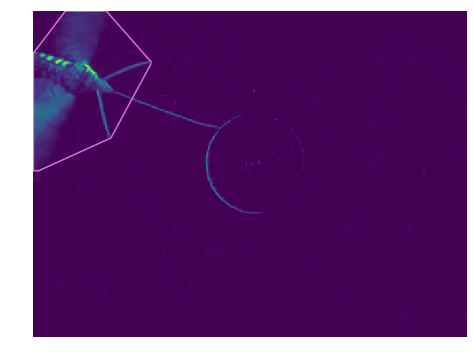

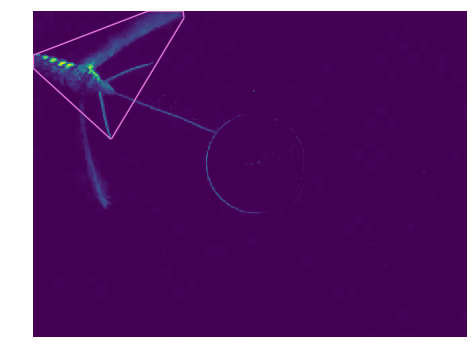

...

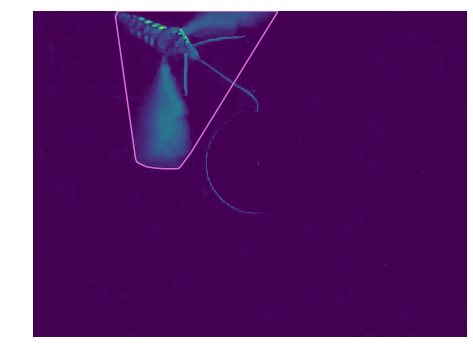

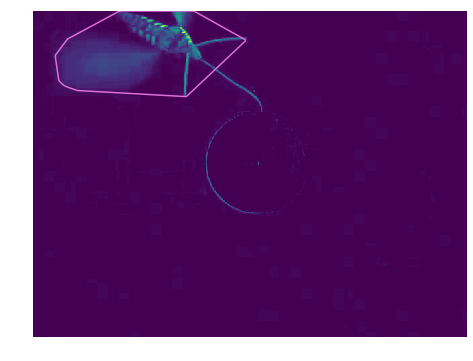

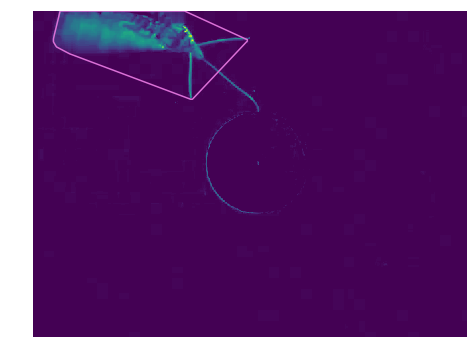

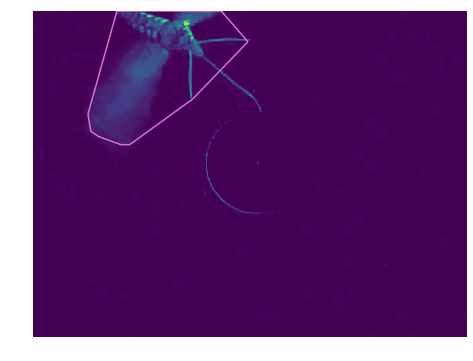

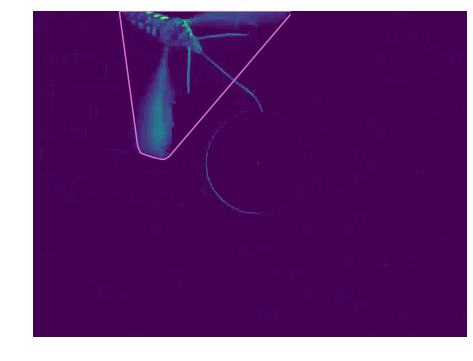

In [10]:
dFrame = pd.read_csv(file_truet)
for name in list_videos[15:16]:
    print(name)
    frameNum = np.arange(68863,70169)
    contours = []
    centroids_x = []
    centroids_y = []
    contours_hull = []
    centroids_hull_x = []
    centroids_hull_y = []
    frame_ = []

    i = 0
    for frame in frameNum:
        back, cur, diff = VideoPull(0,frame, name, video)
        contour, contour_hull, centroid, centroid_hull = MotionParameters(diff)
        contours.append(contour)
        centroids_x.append(centroid[0])
        centroids_y.append(centroid[1])
        contours_hull.append(contour_hull)
        centroids_hull_x.append(centroid_hull[0])
        centroids_hull_y.append(centroid_hull[1])
        frame_.append(frame)
        
         
        i+=1
        if not len(contour) >= 1:
            
            plt.imshow(diff)
            plt.axis('off')
            plt.savefig(contour_vid + "\\" + str(frame) + ".png")
            
        else: 
            
            fig = plt.figure(figsize = (20,6))
           
            
            plt.imshow(diff)
            plt.axis('off')
            plt.plot(np.squeeze(contour_hull)[:,0],np.squeeze(contour_hull)[:,1],'orchid')
#             plt.plot(centroid_hull[0],centroid_hull[1], 'o', color='gold', markersize = 10)
#             plt.savefig(contour_vid + "\\" + str(frame) + ".png")
            
#     new_df = (pd.DataFrame({'FrameNumber' : frame_, 'Name': name, 'X_position' : centroids_hull_x, 
#                                 'Y_position' : centroids_hull_y}))
#     second_last_outpath = r"C:\Users\Daniellab\Desktop\Light_level_videos_second_batch\Data\Motion_Analysis\First_Last_Centroids\Second_Last"
#     new_df.to_csv(second_last_outpath + "//" + 'Final_position_centroid_method_Last_SecondTrial_' + name + '.csv')

L0.1_c-3_m40


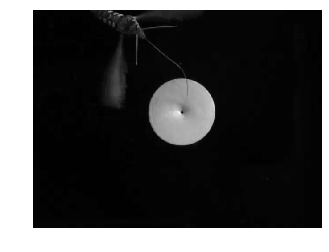

In [39]:
for name in list_videos[15:16]:
    print(name)
    frameNum = np.arange(68863,70169)
    contours = []
    centroids_x = []
    centroids_y = []
    contours_hull = []
    centroids_hull_x = []
    centroids_hull_y = []
    frame_ = []

    i = 0
    for frame in frameNum:
        back, cur, diff = VideoPull(0,frame, name, video)
        plt.imshow(cur, cmap = 'gray')
#         plt.axis('off')
#         plt.savefig(r"C:\Users\Daniellab\Desktop\Jorge_Analysis\Contour_Video\og" + "\\" + str(frame) + ".png")

In [11]:
tempImgDirectory = os.path.join(os.path.dirname(contour_vid))
# convert images to video with ffmpeg
os.chdir(contour_vid)
print(contour_vid)
# use ffmpeg to convert directory to video
# -r is output frame rate
os.system('ffmpeg -start_number 68863 -r 30 -i %04d.png -vf "scale=trunc(iw/2)*2:trunc(ih/2)*2" -c:v libx264 -pix_fmt yuv420p -y jorgevid.mp4')

C:\Users\Daniellab\Desktop\Light_level_videos_second_batch\Data\Motion_Analysis\Centroids\Figure


0

In [23]:
os.chdir(video)
video

'C:\\Users\\Daniellab\\Desktop\\Light_level_videos_second_batch\\Videos\\All_videos_used_for_analysis'

In [40]:
# tempImgDirectory = os.path.join(os.path.dirname(r"C:\Users\Daniellab\Desktop\Jorge_Analysis\Contour_Video\og"))
os.chdir(r"C:\Users\Daniellab\Desktop\Jorge_Analysis\Contour_Video\og")
os.system('ffmpeg -start_number 68863 -r 30 -i %04d.png -vf "scale=trunc(iw/2)*2:trunc(ih/2)*2" -c:v libx264 -pix_fmt yuv420p -y ogjorgevid.mp4')

0